<a href="https://colab.research.google.com/github/IdoBecher/Image-Segmentation-of-Spores/blob/main/Image_Segmentation_of_Spores.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
import numpy as np
import cv2
import pandas as pd
from glob import glob
from tqdm import tqdm
import tensorflow as tf
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, jaccard_score, precision_score, recall_score
from albumentations import HorizontalFlip, VerticalFlip, Rotate
import tensorflow.keras as keras
from tensorflow.keras.utils import CustomObjectScope
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger, ReduceLROnPlateau, EarlyStopping, TensorBoard
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import Recall, Precision

In [3]:
def create_dir(path):
    """ Create a directory. """
    if not os.path.exists(path):
        os.makedirs(path)

def load_data(path, split=0.2):
    """ Load the images and masks """
    images = sorted(glob(f"{path}/train images/*.png"))
    masks = sorted(glob(f"{path}/train masks/*.png"))
    print(len(images))
    """ Split the data """
    split_size = int(len(images) * split)
    train_x, valid_x = train_test_split(images, test_size=split_size, random_state=42)
    train_y, valid_y = train_test_split(masks, test_size=split_size, random_state=42)

    return (train_x, train_y), (valid_x, valid_y)

def augment_data(images, masks, save_path, augment=True):
    """ Performing data augmentation. """
    H = 128
    W = 128

    for idx, (x, y) in tqdm(enumerate(zip(images, masks)), total=len(images)):
        """ Extracting the dir name and image name """
        dir_name = x.split("/")[-3]
        name = dir_name + "_" + x.split("/")[-1].split(".")[0]

        """ Read the image and mask """
        x = cv2.imread(x, cv2.IMREAD_COLOR)
        y = cv2.imread(y, cv2.IMREAD_COLOR)

        if augment == True:
            aug = HorizontalFlip(p=1.0)
            augmented = aug(image=x, mask=y)
            x1 = augmented["image"]
            y1 = augmented["mask"]

            aug = VerticalFlip(p=1)
            augmented = aug(image=x, mask=y)
            x2 = augmented['image']
            y2 = augmented['mask']

            aug = Rotate(limit=45, p=1.0)
            augmented = aug(image=x, mask=y)
            x3 = augmented["image"]
            y3 = augmented["mask"]

            X = [x, x1, x2, x3]
            Y = [y, y1, y2, y3]

        else:
            X = [x]
            Y = [y]

        idx = 0
        for i, m in zip(X, Y):
            i = cv2.resize(i, (W, H))
            m = cv2.resize(m, (W, H))
            m = m/255.0
            m = (m > 0.5) * 255

            if len(X) == 1:
                tmp_image_name = f"{name}.jpg"
                tmp_mask_name  = f"{name}.jpg"
            else:
                tmp_image_name = f"{name}_{idx}.jpg"
                tmp_mask_name  = f"{name}_{idx}.jpg"

            image_path = os.path.join(save_path, "image/", tmp_image_name)
            mask_path  = os.path.join(save_path, "mask/", tmp_mask_name)

            cv2.imwrite(image_path, i)
            cv2.imwrite(mask_path, m)

            idx += 1




""" Load the dataset """
dataset_path = '/content/drive/MyDrive/dataset3'
(train_x, train_y), (valid_x, valid_y) = load_data(dataset_path, split=0.2)

print("Train: ", len(train_x))
print("Valid: ", len(valid_x))

create_dir("new_data/train/image/")
create_dir("new_data/train/mask/")
create_dir("new_data/valid/image/")
create_dir("new_data/valid/mask/")

#augment_data(train_x, train_y, "new_data/train/", augment=True)
#augment_data(valid_x, valid_y, "new_data/valid/", augment=False)

8990
Train:  7192
Valid:  1798


In [4]:
augment_data(train_x, train_y, "new_data/train/", augment=True)
augment_data(valid_x, valid_y, "new_data/valid/", augment=False)

100%|██████████| 1798/1798 [07:46<00:00,  3.86it/s]


In [5]:
def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x


def encoder_block(input, num_filters):
    x = conv_block(input, num_filters)
    p = MaxPool2D((2, 2))(x)
    return x, p


def decoder_block(input, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

def build_unet(input_shape):
    inputs = Input(input_shape)

    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)
    s3, p3 = encoder_block(p2, 256)
    s4, p4 = encoder_block(p3, 512)

    b1 = conv_block(p4, 1024)

    d1 = decoder_block(b1, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    outputs = Conv2D(1, 1, padding="same", activation="sigmoid")(d4)

    model = Model(inputs, outputs, name="U-Net")
    return model



input_shape = (128, 128, 3)
model = build_unet(input_shape)
model.summary()

Model: "U-Net"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 128, 128, 64  256        ['conv2d[0][0]']                 
 alization)                     )                                                             

In [6]:
def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

smooth = 1e-15
def dice_coef(y_true, y_pred):
    y_true = tf.keras.layers.Flatten()(y_true)
    y_pred = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)

def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

In [10]:
H = 128
W = 128

def shuffling(x, y):
    x, y = shuffle(x, y, random_state=42)
    return x, y

def load_data(path):
    x = sorted(glob(os.path.join(path, "image", "*.jpg")))
    y = sorted(glob(os.path.join(path, "mask", "*.jpg")))
    return x, y

def read_image(path):
    path = path.decode()
    x = cv2.imread(path, cv2.IMREAD_COLOR)
    x = x/255.0
    x = x.astype(np.float32)
    return x

def read_mask(path):
    path = path.decode()
    x = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    x = x/255.0
    x = x > 0.5
    x = x.astype(np.float32)
    x = np.expand_dims(x, axis=-1)
    return x

def tf_parse(x, y):
    def _parse(x, y):
        x = read_image(x)
        y = read_mask(y)
        return x, y

    x, y = tf.numpy_function(_parse, [x, y], [tf.float32, tf.float32])
    x.set_shape([H, W, 3])
    y.set_shape([H, W, 1])
    return x, y

def tf_dataset(x, y, batch=8):
    dataset = tf.data.Dataset.from_tensor_slices((x, y))
    dataset = dataset.map(tf_parse)
    dataset = dataset.batch(batch)
    dataset = dataset.prefetch(10)
    return dataset



""" Seeding """
np.random.seed(42)
tf.random.set_seed(42)

""" Directory for storing files """
create_dir("files")

""" Hyperparameters """
batch_size = 32
lr = 1e-4
num_epochs = 5
model_path = os.path.join("/content/drive/MyDrive", "mask_rcnn_coco.h5")
csv_path = os.path.join("files", "data.csv")

""" Dataset """
dataset_path = os.path.join("new_data")
train_path = os.path.join(dataset_path, "train")
valid_path = os.path.join(dataset_path, "valid")

train_x, train_y = load_data('/content/new_data/train')
train_x, train_y = shuffling(train_x, train_y)
valid_x, valid_y = load_data(valid_path)

print(f"Train: {len(train_x)} - {len(train_y)}")
print(f"Valid: {len(valid_x)} - {len(valid_y)}")

train_dataset = tf_dataset(train_x, train_y, batch=batch_size)
valid_dataset = tf_dataset(valid_x, valid_y, batch=batch_size)





Train: 28768 - 28768
Valid: 1798 - 1798


In [11]:

""" Model """
model = build_unet((H, W, 3))
metrics = [dice_coef, iou, Recall(), Precision()]
model.compile(loss=dice_loss, optimizer=Adam(lr), metrics=metrics)

callbacks = [
    ModelCheckpoint(model_path, verbose=1, save_best_only=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=10, min_lr=1e-7, verbose=1),
    CSVLogger(csv_path),
    TensorBoard(),
    EarlyStopping(monitor='val_loss', patience=50, restore_best_weights=False),
]


In [12]:

model.fit(
  train_dataset,
    epochs=10,
    validation_data=valid_dataset,
    callbacks=callbacks,
    shuffle=False
)

Epoch 1/10
899/899 [==============================] - ETA: 0s - loss: 0.4526 - dice_coef: 0.5474 - iou: 0.3833 - recall_1: 0.7358 - precision_1: 0.4970
Epoch 1: val_loss improved from inf to 0.36729, saving model to /content/drive/MyDrive/mask_rcnn_coco.h5
899/899 [==============================] - 417s 453ms/step - loss: 0.4526 - dice_coef: 0.5474 - iou: 0.3833 - recall_1: 0.7358 - precision_1: 0.4970 - val_loss: 0.3673 - val_dice_coef: 0.6330 - val_iou: 0.4647 - val_recall_1: 0.7068 - val_precision_1: 0.6507 - lr: 1.0000e-04
Epoch 2/10
899/899 [==============================] - ETA: 0s - loss: 0.3233 - dice_coef: 0.6767 - iou: 0.5123 - recall_1: 0.7257 - precision_1: 0.6709
Epoch 2: val_loss improved from 0.36729 to 0.31258, saving model to /content/drive/MyDrive/mask_rcnn_coco.h5
899/899 [==============================] - 407s 452ms/step - loss: 0.3233 - dice_coef: 0.6767 - iou: 0.5123 - recall_1: 0.7257 - precision_1: 0.6709 - val_loss: 0.3126 - val_dice_coef: 0.6883 - val_iou: 0.5

In [13]:
def save_results(image, mask, y_pred, save_image_path):
    ## i - m - y
    line = np.ones((H, 10, 3)) * 128

    """ Mask """
    mask = np.expand_dims(mask, axis=-1)    ## (512, 512, 1)
    mask = np.concatenate([mask, mask, mask], axis=-1)  ## (512, 512, 3)

    """ Predicted Mask """
    y_pred = np.expand_dims(y_pred, axis=-1)    ## (512, 512, 1)
    y_pred = np.concatenate([y_pred, y_pred, y_pred], axis=-1)  ## (512, 512, 3)
    y_pred = y_pred * 255

    cat_images = np.concatenate([image, line, mask, line, y_pred], axis=1)
    cv2.imwrite(save_image_path, cat_images)



In [14]:
""" Seeding """
np.random.seed(42)
tf.random.set_seed(42)

""" Directory for storing files """
create_dir("results3")

""" Load the dataset """
test_x = sorted(glob(os.path.join("new_data", "valid", "image", "*")))
test_y = sorted(glob(os.path.join("new_data", "valid", "mask", "*")))
print(f"Test: {len(test_x)} - {len(test_y)}")

""" Evaluation and Prediction """
SCORE = []
for x, y in tqdm(zip(test_x, test_y), total=len(test_x)):
    """ Extract the name """
    name = x.split("/")[-1].split(".")[0]

    """ Reading the image """
    image = cv2.imread(x, cv2.IMREAD_COLOR)
    x = image/255.0
    x = np.expand_dims(x, axis=0)

    """ Reading the mask """
    mask = cv2.imread(y, cv2.IMREAD_GRAYSCALE)
    y = mask/255.0
    y = y > 0.5
    y = y.astype(np.int32)

    """ Prediction """
    y_pred = model.predict(x)[0]
    y_pred = np.squeeze(y_pred, axis=-1)
    y_pred = y_pred > 0.5
    y_pred = y_pred.astype(np.int32)

    """ Saving the prediction """
    save_image_path = f"results3/{name}.png"
    save_results(image, mask, y_pred, save_image_path)

    """ Flatten the array """
    y = y.flatten()
    y_pred = y_pred.flatten()

    """ Calculating the metrics values """
    acc_value = accuracy_score(y, y_pred)
    f1_value = f1_score(y, y_pred, labels=[0, 1], average="binary", zero_division=1)
    jac_value = jaccard_score(y, y_pred, labels=[0, 1], average="binary", zero_division=1)
    recall_value = recall_score(y, y_pred, labels=[0, 1], average="binary", zero_division=1)
    precision_value = precision_score(y, y_pred, labels=[0, 1], average="binary", zero_division=1)
    SCORE.append([name, acc_value, f1_value, jac_value, recall_value, precision_value])

""" Metrics values """
score = [s[1:]for s in SCORE]
score = np.mean(score, axis=0)
print(f"Accuracy: {score[0]:0.5f}")
print(f"F1: {score[1]:0.5f}")
print(f"Jaccard: {score[2]:0.5f}")
print(f"Recall: {score[3]:0.5f}")
print(f"Precision: {score[4]:0.5f}")

df = pd.DataFrame(SCORE, columns=["Image", "Accuracy", "F1", "Jaccard", "Recall", "Precision"])
df.to_csv("files/score.csv")

Test: 1798 - 1798


100%|██████████| 1798/1798 [02:16<00:00, 13.13it/s]

Accuracy: 0.96910
F1: 0.73728
Jaccard: 0.60904
Recall: 0.75513
Precision: 0.76264


In [15]:
import matplotlib.pyplot as plt
plt.figure(figsize = (15, 15))

titleTxt = ['Input Image', 'True Mask', 'Predicted Mask']
imgList = cv2.imread(os.path.join('/content/results3','dataset3_07_09_20_1_CB_101_0.png'))
type(imgList)

numpy.ndarray

<Figure size 1080x1080 with 0 Axes>

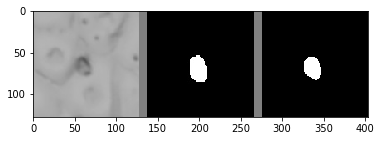

In [16]:
plt.imshow(imgList, interpolation='nearest')
plt.show()

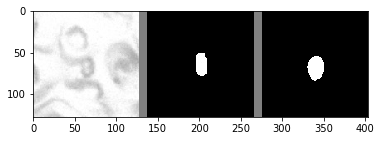

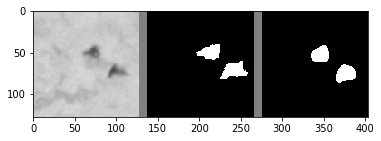

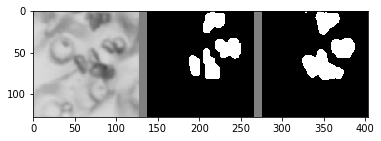

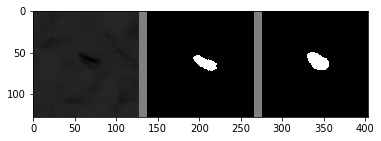

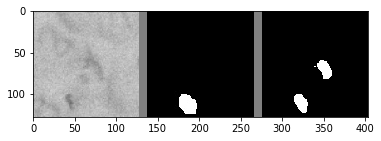

...

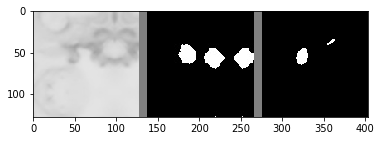

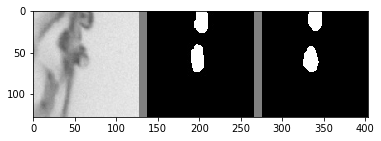

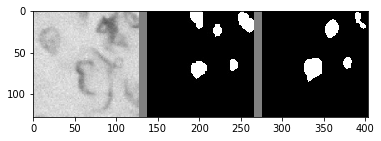

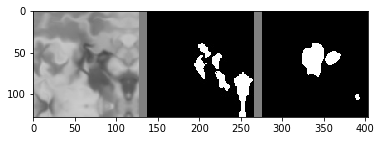

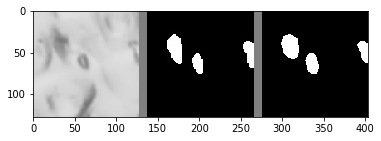

In [17]:
folder = '/content/results3'
for filename in os.listdir(folder):
  img = cv2.imread(os.path.join(folder,filename))
  plt.imshow(img, interpolation='nearest')
  plt.show()